# EDA Germany 

In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from datetime import date, time, datetime
from IPython import display
import os
import datetime

In [2]:
#Create dataframe from CSV
df = pd.read_csv("../data/fromAPI/cleaned_hourly_all3.csv")



In [3]:
date_format = "%Y-%m-%d %H:%M:%S"
df["arrival_plan"] = pd.to_datetime(df["arrival_plan"], format=date_format)
df["departure_plan"] = pd.to_datetime(df["departure_plan"], format=date_format)
df["arrival_change"] = pd.to_datetime(df["arrival_change"], format=date_format)
df["departure_change"] = pd.to_datetime(df["departure_change"], format=date_format)

df["arrival_plan_time"] = df["arrival_plan"].dt.time
df["arrival_plan_date"] = df["arrival_plan"].dt.date

df["departure_plan_time"] = df["departure_plan"].dt.time
df["departure_plan_date"] = df["departure_plan"].dt.date

df.drop(labels=["ID", "eva_nr", "zip"], axis=1, inplace=True)

In [4]:
df.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,departure_change,arrival_delay_m,departure_delay_m,info,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,2024-07-08 00:04:00,3,3,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08
1,18,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,NaT,0,0,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,2024-07-08 00:04:00,0,0,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08
3,18,Aachen Hbf,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaT,0,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08
4,33,Herzogenrath|Kohlscheid,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,2024-07-08 00:21:00,0,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1545209 entries, 0 to 1545208
Data columns (total 21 columns):
 #   Column                 Non-Null Count    Dtype         
---  ------                 --------------    -----         
 0   line                   1545209 non-null  object        
 1   path                   1386703 non-null  object        
 2   category               1545209 non-null  int64         
 3   station                1545209 non-null  object        
 4   state                  1545209 non-null  object        
 5   city                   1545209 non-null  object        
 6   long                   1545209 non-null  float64       
 7   lat                    1545209 non-null  float64       
 8   arrival_plan           1386703 non-null  datetime64[ns]
 9   departure_plan         1545209 non-null  datetime64[ns]
 10  arrival_change         1190305 non-null  datetime64[ns]
 11  departure_change       1293401 non-null  datetime64[ns]
 12  arrival_delay_m        15452

In [6]:
df.describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m
count,1.545209e+06,1.545209e+06,1.545209e+06,1386703,1545209,1190305,1293401,1.545209e+06,1.545209e+06
mean,3.873418e+00,1.017980e+01,5.087272e+01,2024-07-10 13:29:41.578955264,2024-07-10 13:29:11.159927040,2024-07-10 13:28:27.067986176,2024-07-10 13:27:08.839811328,1.262979e+00,1.309834e+00
min,1.000000e+00,6.070715e+00,4.741103e+01,2024-07-07 23:37:00,2024-07-08 00:00:00,2024-07-07 23:39:00,2024-07-08 00:00:00,0.000000e+00,0.000000e+00
25%,3.000000e+00,8.494792e+00,4.934848e+01,2024-07-09 08:53:00,2024-07-09 08:51:00,2024-07-09 09:00:00,2024-07-09 08:58:00,0.000000e+00,0.000000e+00
50%,4.000000e+00,9.935780e+00,5.106590e+01,2024-07-10 13:41:00,2024-07-10 13:39:00,2024-07-10 13:40:00,2024-07-10 13:37:00,0.000000e+00,0.000000e+00
75%,5.000000e+00,1.208564e+01,5.247808e+01,2024-07-11 18:07:00,2024-07-11 18:07:00,2024-07-11 17:58:00,2024-07-11 17:58:00,1.000000e+00,1.000000e+00
max,5.000000e+00,1.497908e+01,5.490684e+01,2024-07-12 23:59:00,2024-07-13 00:12:00,2024-07-13 00:47:00,2024-07-13 00:48:00,1.590000e+02,1.590000e+02
std,1.035577e+00,2.273605e+00,1.790447e+00,NaN,NaN,NaN,NaN,3.526700e+00,3.533421e+00


In [7]:
df.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,departure_change,arrival_delay_m,departure_delay_m,info,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,2024-07-08 00:04:00,3,3,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08
1,18,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,NaT,0,0,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,2024-07-08 00:04:00,0,0,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08
3,18,Aachen Hbf,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaT,0,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08
4,33,Herzogenrath|Kohlscheid,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,2024-07-08 00:21:00,0,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08


# Temporal analysis

arranging the data and creating new features

In [8]:
df_temp_arr = df.dropna(subset=["arrival_plan"])
df_temp_dep = df.dropna(subset=["departure_plan"])

date_format = "%Y-%m-%d %H:%M:%S"
df_temp_arr = df.dropna(subset=["arrival_plan"]).copy()
df_temp_arr.loc[:, "arrival_plan_hour"] = df_temp_arr["arrival_plan"].dt.hour
df_temp_arr.loc[:, "arrival_plan_datetime"] = (
    df_temp_arr["arrival_plan_date"].astype(str) + ' ' +
    df_temp_arr["arrival_plan_hour"].astype(str) + ':00:00'
)
df_temp_arr.loc[:, "arrival_plan_datetime"] = pd.to_datetime(df_temp_arr["arrival_plan_datetime"], format=date_format)


df_temp_dep = df.dropna(subset=["departure_plan"]).copy()
df_temp_dep.loc[:, "departure_plan_hour"] = df_temp_dep["departure_plan"].dt.hour
df_temp_dep.loc[:, "departure_plan_datetime"] = (
    df_temp_dep["departure_plan_date"].astype(str) + ' ' +
    df_temp_dep["departure_plan_hour"].astype(str) + ':00:00'
)
df_temp_dep.loc[:, "departure_plan_datetime"] = pd.to_datetime(df_temp_dep["departure_plan_datetime"], format=date_format)

df_temp_arr_plt = df_temp_arr.groupby("arrival_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_dep_plt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)

creating a list of the 25% best and 25% worst stations (by delay%)

In [10]:
df_temp_cnt = df_temp_dep.groupby("station", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["station"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["station"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["station","departure_plan_hour"]], df_temp_cnt2[["station","departure_plan"]], how='left', on="station", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["station","departure_plan"]], how='left', on="station", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100


In [12]:
best = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] < df_temp_cnt["delay_cnt/departure"].quantile(0.25)].station.values
worst = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] > df_temp_cnt["delay_cnt/departure"].quantile(0.75)].station.values

regrouping the dataframe for temporal analysis

In [13]:
df_temp_cnt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["departure_plan_datetime","departure_plan_hour"]], df_temp_cnt2[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100

In [14]:
df_temp_cnt.head()

,departure_plan_datetime,departure_plan_hour,departure_plan,departure_plan_count,delay_cnt/departure
0,2024-07-08 00:00:00,0.0,6521,268.0,4.109799
1,2024-07-08 01:00:00,1.0,2567,108.0,4.207246
2,2024-07-08 02:00:00,2.0,475,21.0,4.421053
3,2024-07-08 03:00:00,3.0,681,10.0,1.468429
4,2024-07-08 04:00:00,4.0,5483,38.0,0.693051


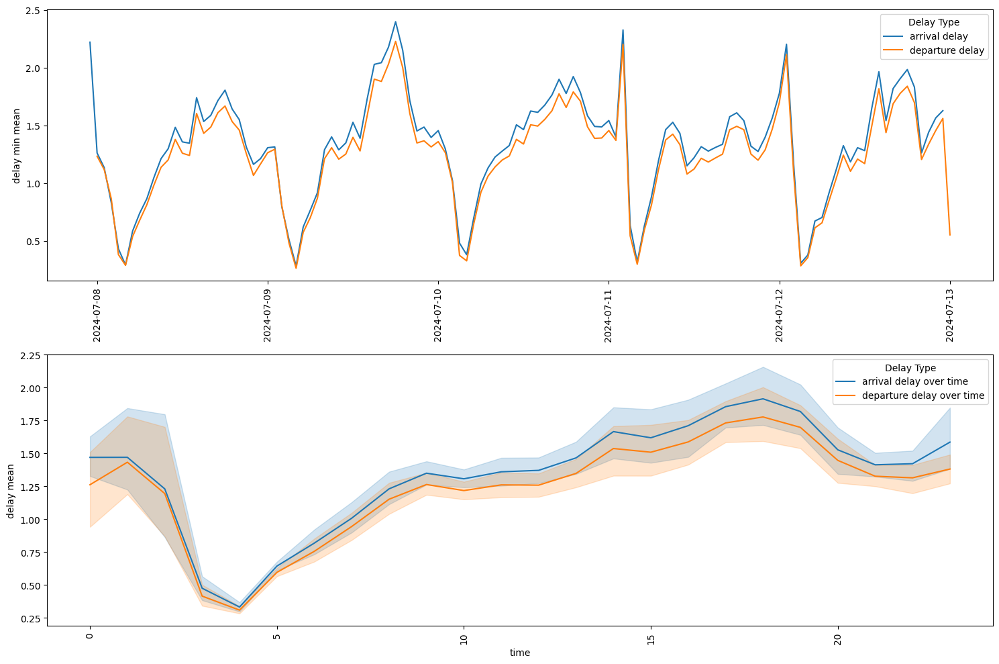

In [15]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_arr_plt, x="arrival_plan_datetime", y="arrival_delay_m", label="arrival delay", ax=axes[0])
sns.lineplot(df_temp_dep_plt, x="departure_plan_datetime", y="departure_delay_m", label="departure delay", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay min mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_arr_plt, x="arrival_plan_hour", y="arrival_delay_m", label="arrival delay over time", ax=axes[1])
sns.lineplot(df_temp_dep_plt, x="departure_plan_hour", y="departure_delay_m", label="departure delay over time", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


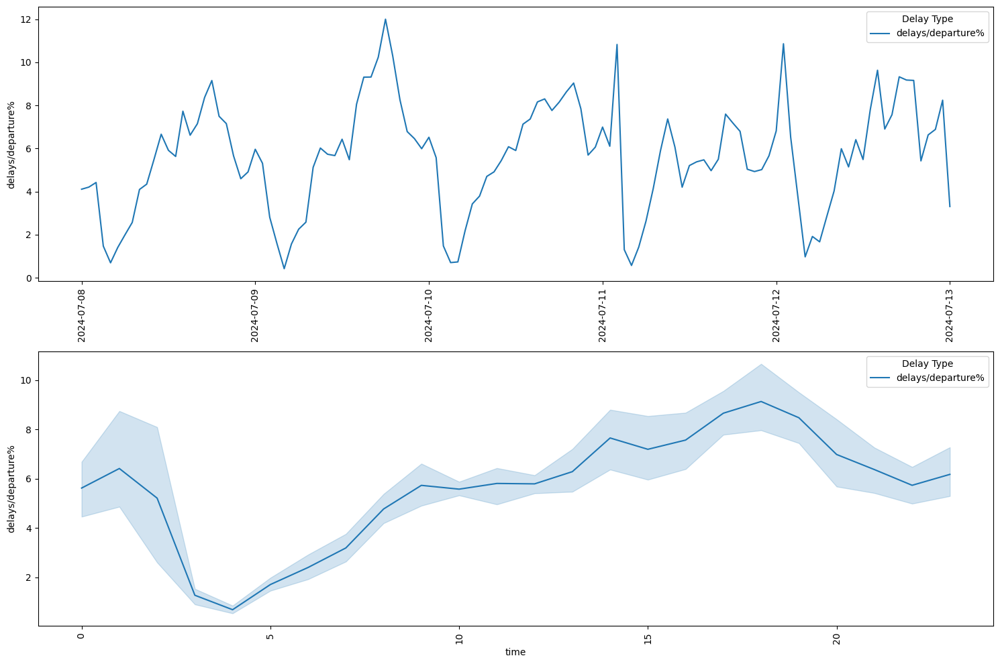

In [16]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_cnt, x="departure_plan_datetime", y="delay_cnt/departure", label="delays/departure%", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delays/departure%")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_cnt, x="departure_plan_hour", y="delay_cnt/departure", label="delays/departure%", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delays/departure%")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


the data indicates a seasonality with peaks around late afternoon around 16:00.<br>
the gap on the 24th comes from a gap in the data collection around that time

as arrival and departure follow a similar temporal pattern, we will only discuss departure going further, as most departure delays also inherit arrival delays, but they can also be the source.

In [17]:
df_temp_cat = df_temp_dep.groupby(["departure_plan_datetime", "category"], as_index=False).departure_delay_m.mean()
df_temp_cat2 = df_temp_dep.groupby(["departure_plan_hour", "category"], as_index=False).departure_delay_m.mean()


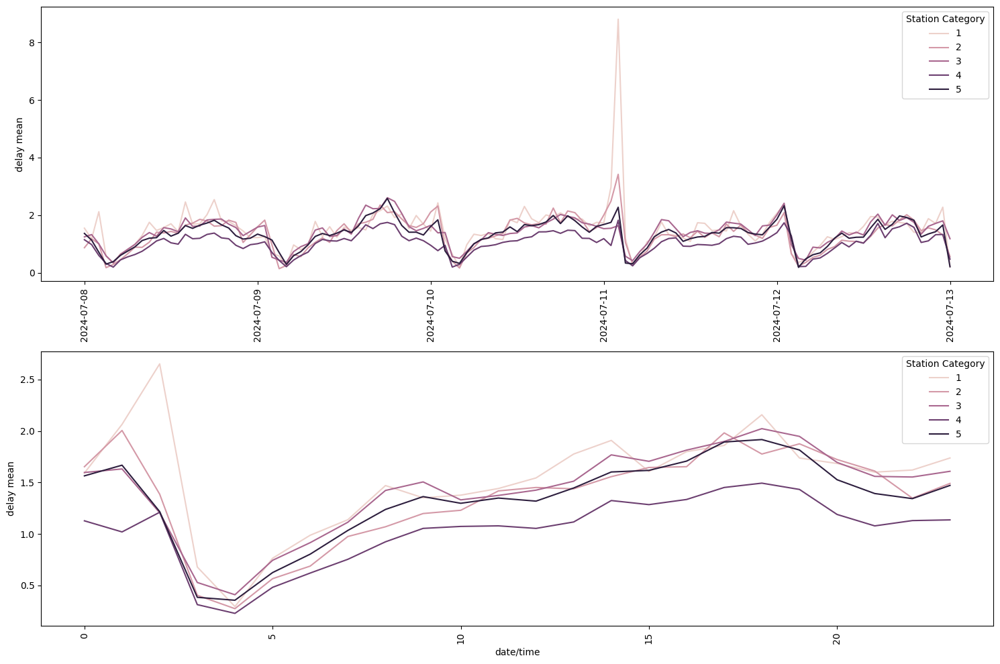

In [18]:
# Create a figure with two subplots arranged vertically
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival delays over datetime with category hue
sns.lineplot(df_temp_cat, x="departure_plan_datetime", y="departure_delay_m", hue="category", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Station Category")

# Second plot: arrival delays over time of day with category hue
sns.lineplot(df_temp_cat2, x="departure_plan_hour", y="departure_delay_m", hue="category", ax=axes[1])
axes[1].set_xlabel("date/time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Station Category")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


In [19]:
df.state.unique()


array(['Nordrhein-Westfalen', 'Baden-Württemberg', 'Niedersachsen',
       'Schleswig-Holstein', 'Bayern', 'Berlin', 'Hamburg', 'Thüringen',
       'Rheinland-Pfalz', 'Mecklenburg-Vorpommern', 'Sachsen',
       'Sachsen-Anhalt', 'Brandenburg', 'Hessen', 'Saarland', 'Bremen'],
      dtype=object)

In [20]:
statelist = df.state.unique()
frames = {}
for state in statelist:
    frames[state] = df[df["state"] == state]



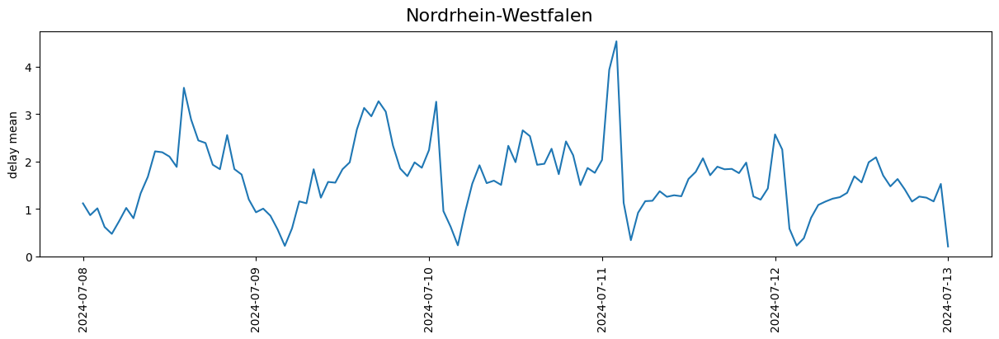

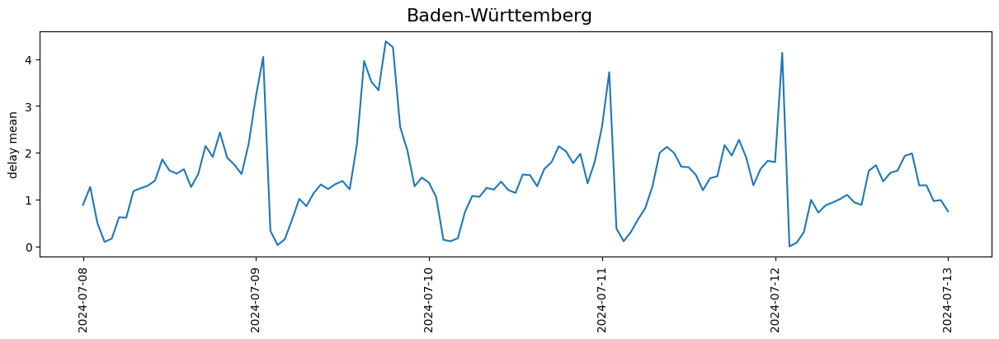

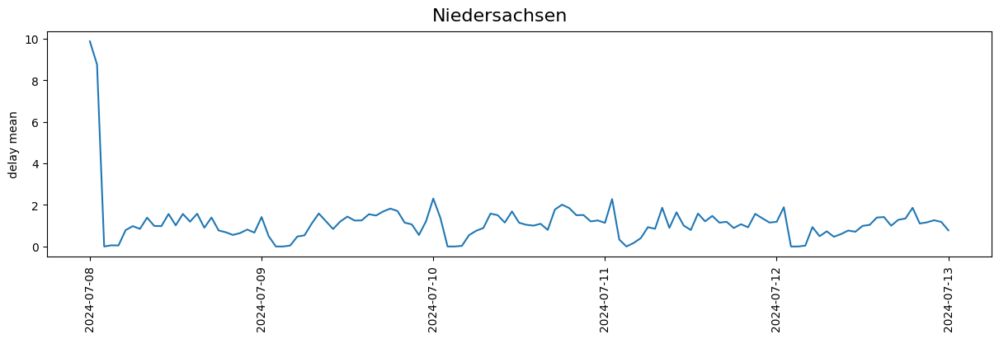

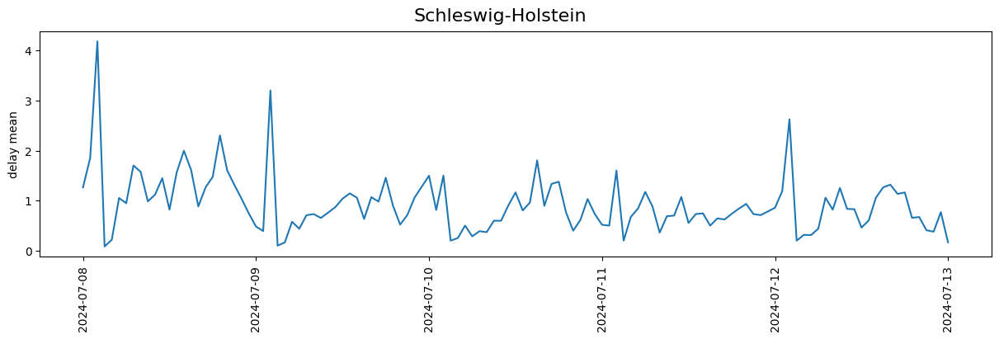

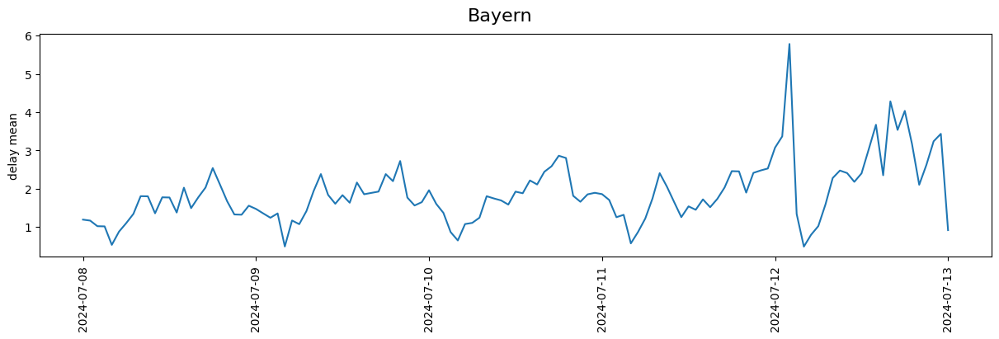

...

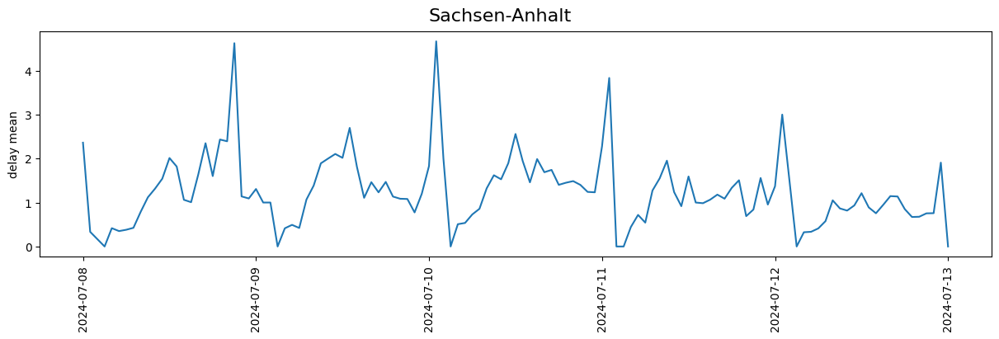

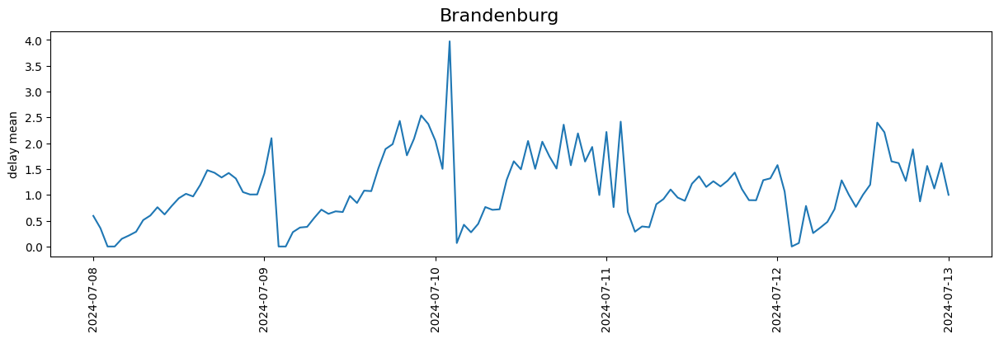

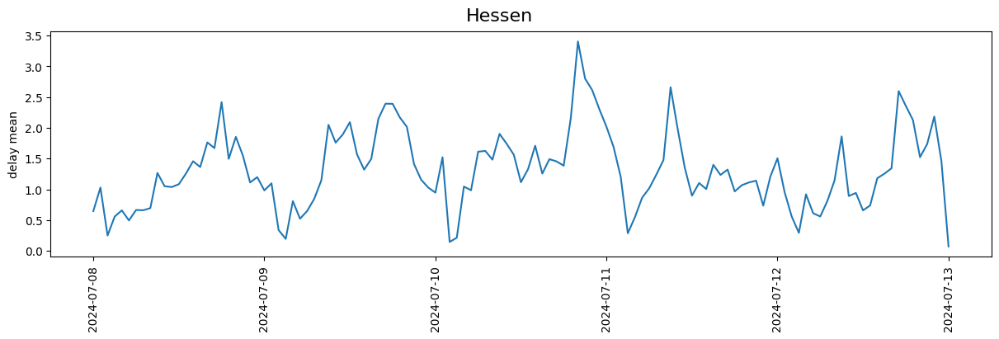

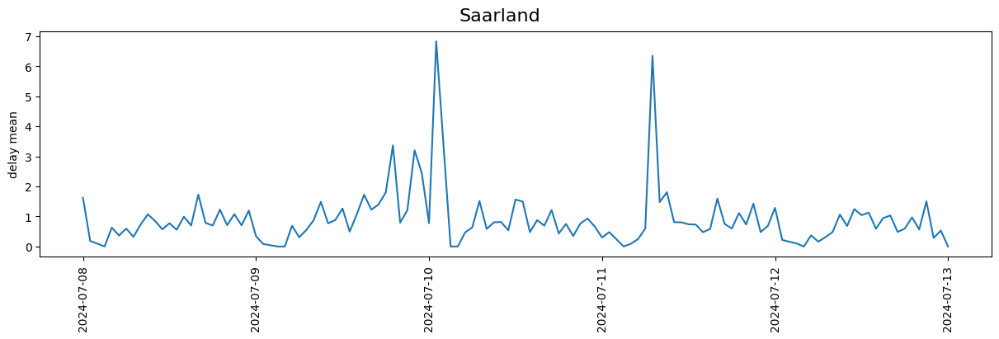

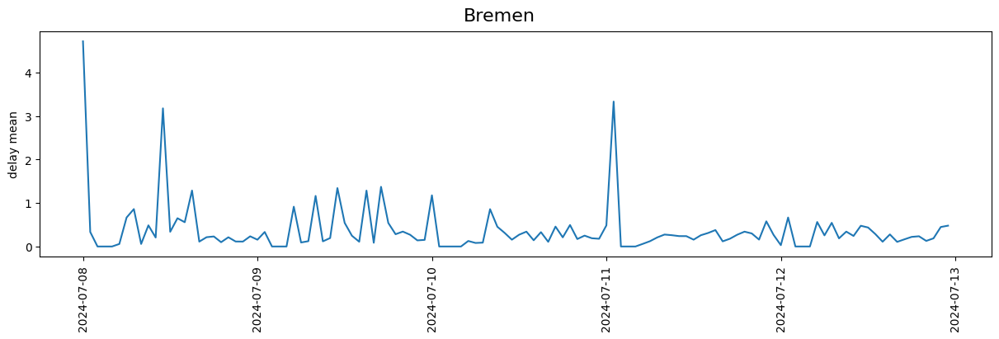

In [21]:
for state in statelist:
    fig, axes = plt.subplots(1, 1, figsize=(12, 4), constrained_layout=True)
    df_temp = frames[state].copy()
    df_temp.set_index('departure_plan', inplace=True)
    numeric_cols = df_temp.select_dtypes(include=['float64', 'int64'])
    hourly_data = numeric_cols.resample('h').mean()

    sns.lineplot(hourly_data, x=hourly_data.index,  y="departure_delay_m", ax=axes)
    axes.set_xlabel("")
    axes.set_ylabel("delay mean")
    axes.tick_params(axis='x', rotation=90)
    #axes.legend(title="Station Category")


    fig.suptitle(state, fontsize=16)
    plt.show()



Some states show more seasonality than others, while there are also several outliers present

In [22]:
heatmap_df2 = df_temp_dep.groupby(["station","departure_plan_datetime"], as_index=False ).mean(numeric_only=True)

In [24]:
fig = px.density_mapbox(
    heatmap_df2,
    lat='lat',
    lon='long',
    z='departure_delay_m',
    hover_name='station',
    radius=10,
    range_color=[0, heatmap_df2.departure_delay_m.max()],
    mapbox_style="carto-positron",
    center={"lat": 51.1657, "lon": 10.4515},
    zoom=5,
    width=600,
    height=700,
    title="Departure Delays over time",
    animation_frame="departure_plan_datetime"
)

fig.update_layout(
    margin={"r": 0, "t": 40, "l": 0, "b": 0},  # Reduced margins
    coloraxis_showscale=False
    )
fig.show()

In [25]:
del heatmap_df2, df_temp_arr, df

In [26]:
df_temp_dep.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,departure_delay_m,info,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,3,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08,0,2024-07-08 00:00:00
1,18,NaN,2,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,0,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08,0,2024-07-08 00:00:00
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,0,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08,0,2024-07-08 00:00:00
3,18,Aachen Hbf,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08,0,2024-07-08 00:00:00
4,33,Herzogenrath|Kohlscheid,5,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08,0,2024-07-08 00:00:00


In [27]:
time_format = "%H:%M:%S"
df_temp_dep["departure_plan_time"] = pd.to_datetime(df_temp_dep["departure_plan_time"], format=time_format)
df_temp_dep["departure_plan_minute"] = df_temp_dep["departure_plan_time"].dt.minute

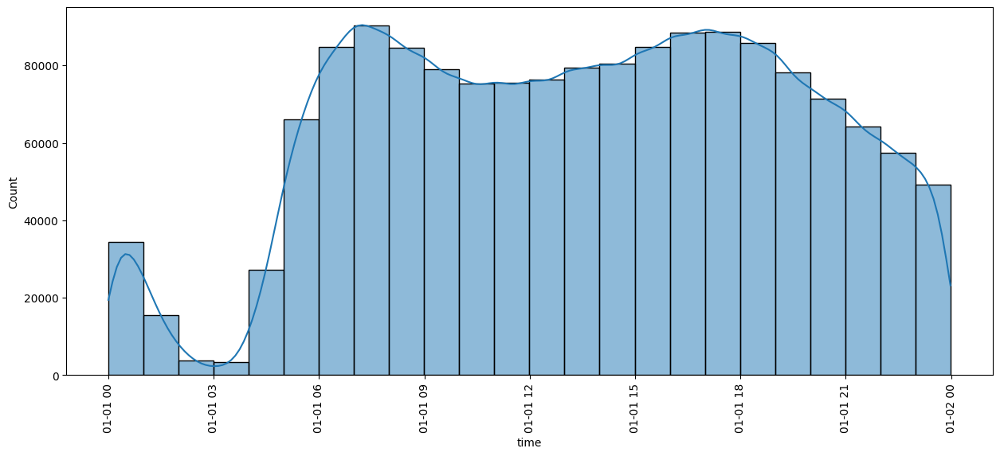

In [36]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
sns.histplot(df_temp_dep, x="departure_plan_time", ax=axes, bins=24, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)

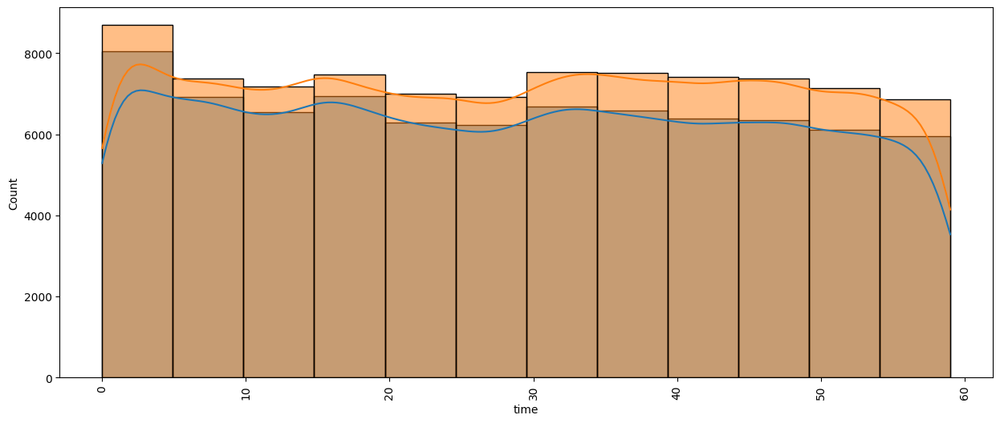

In [38]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
# First plot: arrival and departure delays over datetime
sns.histplot(df_temp_dep[df_temp_dep["departure_plan_hour"] == 9], bins=12, x="departure_plan_minute", label="9", ax=axes, alpha=0.5, kde=True)
sns.histplot(df_temp_dep[df_temp_dep["departure_plan_hour"] == 16],bins=12, x="departure_plan_minute", label="16", ax=axes, alpha=0.5, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)
#axes[0].get_legend().remove()

In [30]:
df_temp_dep.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,info,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime,departure_plan_minute


In [31]:
df_temp_dep[df_temp_dep["station"].isin(worst)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,departure_plan_time,departure_plan_hour,departure_plan_minute
count,0.0,0.0,0.0,0,0,0,0,0.0,0.0,0,0.0,0.0
mean,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
min,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
25%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
50%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
75%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
max,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
df_temp_dep[df_temp_dep["station"].isin(best)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,departure_plan_time,departure_plan_hour,departure_plan_minute
count,0.0,0.0,0.0,0,0,0,0,0.0,0.0,0,0.0,0.0
mean,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
min,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
25%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
50%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
75%,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
max,NaN,NaN,NaN,NaT,NaT,NaT,NaT,NaN,NaN,NaT,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


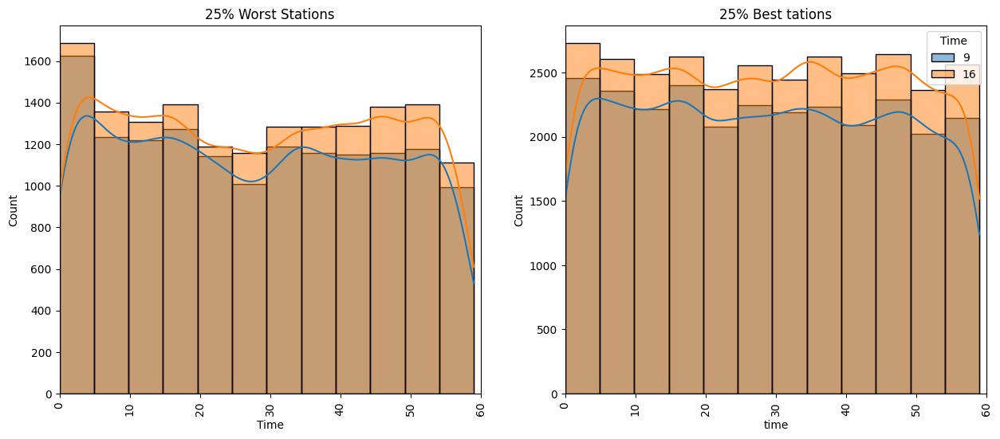

In [39]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 6))



sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 9)&(df_temp_dep["station"].isin(worst))], kde=True, bins=12, label="9", x="departure_plan_minute", ax=axes[0], alpha=0.5)
sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16)&(df_temp_dep["station"].isin(worst))], kde=True, bins=12, label="16", x="departure_plan_minute", ax=axes[0], alpha=0.5)
axes[0].set_xlabel("Time")
axes[0].tick_params(axis='x', rotation=90)
axes[0].set_title("25% Worst Stations")
axes[0].set_xlim([0,60])
#axe[0].get_legend().remove()


sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 9)&(df_temp_dep["station"].isin(best))], kde=True,bins=12, label="9", x="departure_plan_minute", ax=axes[1], alpha=0.5)
sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16)&(df_temp_dep["station"].isin(best))], kde=True,bins=12, label="16", x="departure_plan_minute", ax=axes[1], alpha=0.5)
axes[1].set_xlabel("time")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Time")
axes[1].set_title("25% Best tations")
axes[1].set_xlim([0,60])

plt.show()


In [40]:
def calculate_histogram_bin_counts(data, bins, range):
    counts, _ = np.histogram(data, bins=bins, range=range)
    return counts

bins = 12
range = (0, 60)
data_worst = df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16) & (df_temp_dep["station"].isin(worst))]["departure_plan_minute"]
data_best = df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16) & (df_temp_dep["station"].isin(best))]["departure_plan_minute"]

bin_counts_worst = calculate_histogram_bin_counts(data_worst, bins, range)
bin_counts_best = calculate_histogram_bin_counts(data_best, bins, range)

def gini_coefficient(bin_counts):
    sorted_counts = np.sort(bin_counts)
    n = len(bin_counts)
    index = np.arange(1, n + 1)
    return (2 * np.sum(index * sorted_counts) / (n * np.sum(sorted_counts))) - (n + 1) / n


gini_worst = gini_coefficient(bin_counts_worst)
gini_best = gini_coefficient(bin_counts_best)

print(f"Gini Coefficients \n Worst: {gini_worst.round(3)},\n Best: {gini_best.round(3)}")

Gini Coefficients 
 Worst: 0.056,
 Best: 0.024


The departure times are more evenly distributed at the 25% of best stations than the 25% of worst stations
